# Spectral element DEComposition (SDEC) Plot
SDEC Plot illustrates the contributions of different chemical elements in the formation of a simulation model's spectrum. It is a spectral diagnostic plot similar to those originally proposed by M. Kromer (see, for example, [Kromer et al. 2013](https://arxiv.org/abs/1311.0310), figure 4).

In [1]:
import warnings;
warnings.filterwarnings('ignore');

First create a simulation model for which you want to generate this plot:

In [2]:
from tardis import run_tardis

sim = run_tardis("tardis_example.yml")

  [ TARDIS INFO ][ tardis.plasma.standard_plasmas:assemble_plasma:90 ]- Reading Atomic Data from kurucz_cd23_chianti_H_He.h5
  [ TARDIS INFO ][ tardis.io.atom_data.util:resolve_atom_data_fname:31 ]- Atom Data kurucz_cd23_chianti_H_He.h5 not found in local path. Exists in TARDIS Data repo /home/atharva/Downloads/tardis-data/kurucz_cd23_chianti_H_He.h5
  [ TARDIS INFO ][ tardis.io.atom_data.base:from_hdf:177 ]- Read Atom Data with UUID=6f7b09e887a311e7a06b246e96350010 and MD5=864f1753714343c41f99cb065710cace.
  [ TARDIS INFO ][ tardis.io.atom_data.base:from_hdf:183 ]- Non provided atomic data: synpp_refs, photoionization_data, yg_data, two_photon_data
  [ TARDIS INFO ][ tardis.simulation.base:iterate:323 ]- Starting iteration 1/20
Running post-merge numba montecarlo (with C close lines)!
  [ TARDIS INFO ][ tardis.simulation.base:log_run_results:448 ]- Luminosity emitted = 7.94275e+42 erg / s Luminosity absorbed = 2.65805e+42 erg / s Luminosity requested = 1.05928e+43 erg / s
  [ TARDIS I

  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:440 ]- 
	              t_rad    next_t_rad         w    next_w
	Shell                                                
	0      11567.208184  10569.747403  0.504178  0.442290
	5      11653.124121  11099.194259  0.203042  0.153253
	10     11425.955010  10809.397890  0.125249  0.097256
	15     11082.155938  10454.841299  0.094028  0.073809

  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:441 ]- t_inner 10044.200 K -- next t_inner 11285.966 K
  [ TARDIS INFO ][ tardis.simulation.base:iterate:323 ]- Starting iteration 8/20
Running post-merge numba montecarlo (with C close lines)!
  [ TARDIS INFO ][ tardis.simulation.base:log_run_results:448 ]- Luminosity emitted = 1.33305e+43 erg / s Luminosity absorbed = 4.33011e+42 erg / s Luminosity requested = 1.05928e+43 erg / s
  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:439 ]- Plasma stratification:
  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:440 ]- 
	 

  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:441 ]- t_inner 11175.750 K -- next t_inner 10152.603 K
  [ TARDIS INFO ][ tardis.simulation.base:iterate:323 ]- Starting iteration 15/20
Running post-merge numba montecarlo (with C close lines)!
  [ TARDIS INFO ][ tardis.simulation.base:log_run_results:448 ]- Luminosity emitted = 8.75331e+42 erg / s Luminosity absorbed = 2.81319e+42 erg / s Luminosity requested = 1.05928e+43 erg / s
  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:439 ]- Plasma stratification:
  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:440 ]- 
	              t_rad    next_t_rad         w    next_w
	Shell                                                
	0      11437.188130  10637.774893  0.496749  0.452668
	5      11571.106856  11002.647927  0.196714  0.166197
	10     11378.137918  10832.042108  0.120954  0.101284
	15     10957.211814  10350.602742  0.092896  0.079468

  [ TARDIS INFO ][ tardis.simulation.base:log_plasma_state:441 ]- t_

<div class="alert alert-warning">

**Important:** The virtual packet logging capability must be active in order to produce SDEC Plot. Thus, make sure to set `virtual_packet_logging: True` in your configuration file. It should be added under `virtual` property of `spectrum` property, as described in [configuration schema](https://tardis-sn.github.io/tardis/using/components/configuration/configuration.html#spectrum).

</div>

Now, import the plotting interface for SDEC plot, i.e. `SDECPlotter` class.

In [3]:
from tardis.visualization import SDECPlotter

And create a plotter object to process the data of simulation object `sim` for generating SDEC plots.

In [4]:
plotter = SDECPlotter.from_simulation(sim)

## Static Plot (in matplotlib)
You can now call `generate_plot_mpl()` method on your `plotter` object to get a highly informative, yet beautiful, SDEC plot produced in matplotlib.

### Virtual packets mode
By default, SDEC plot is produced for the virtual packet population of the simulation.

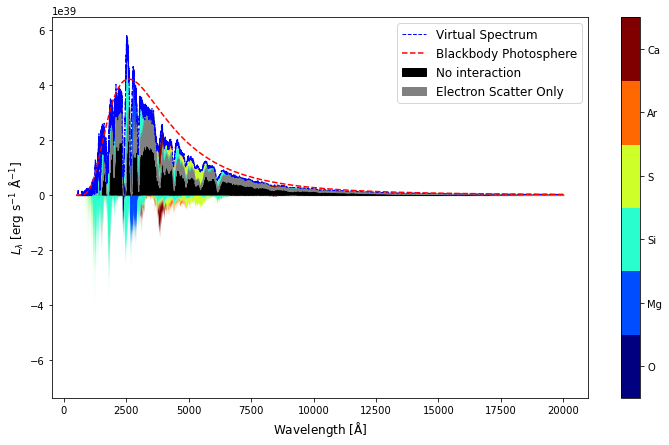

In [5]:
plotter.generate_plot_mpl();

### Real packets mode
You can produce SDEC plot for the real packet population of the simulation by setting `packets_mode="real"` which is `"virtual"` by default. Since `packets_mode` is 1st argument, you can simply pass `"real"` string only.

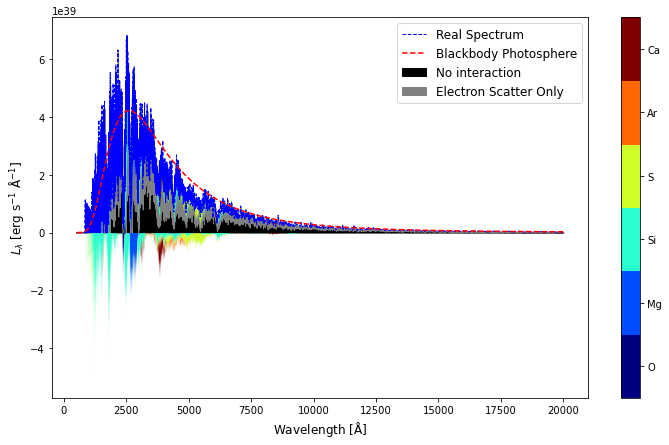

In [6]:
plotter.generate_plot_mpl("real");

### Plotting a specific wavelength range
You can also restrict the wavelength range of escaped packets that you want to plot by specifying `packet_wvl_range`. It should be a quantity having units of Angstrom, containing two values - lower lambda and upper lambda i.e. `[lower_lambda, upper_lambda] * u.AA`.

In [7]:
from astropy import units as u

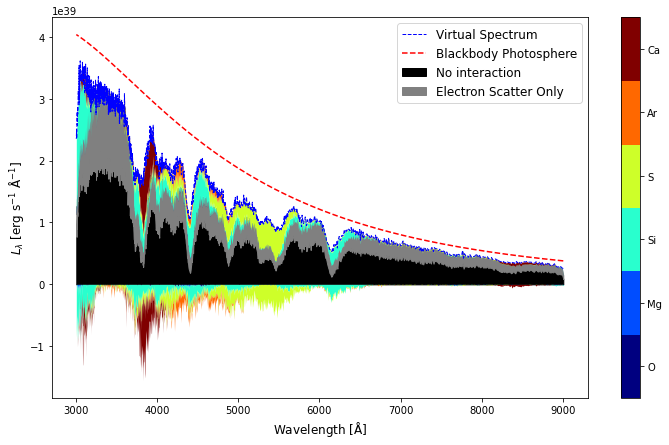

In [8]:
plotter.generate_plot_mpl(packet_wvl_range=[3000, 9000] * u.AA);

### Plotting flux instead of luminosity
You can plot in units of flux on the Y-axis of the SDEC plot, by specifying the `distance` parameter. It should be a quantity with a unit of length like m, Mpc, etc. and must be a positive value. By default, `distance=None` plots luminosity on the Y-axis.

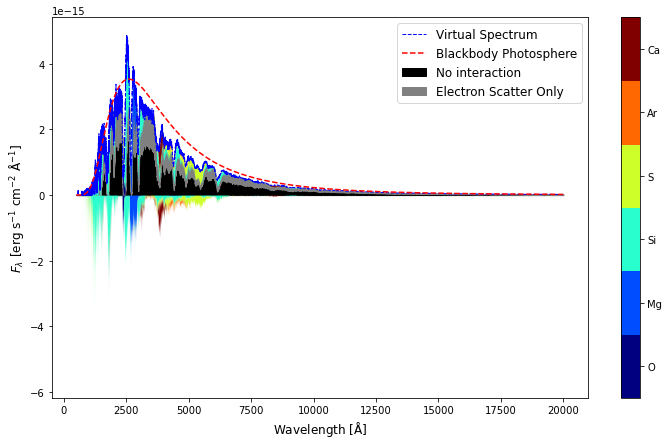

In [9]:
plotter.generate_plot_mpl(distance=100 * u.Mpc);

### Hiding modeled spectrum
By default, modeled spectrum is shown in SDEC plot. You can hide it by setting `show_modeled_spectrum=False`.

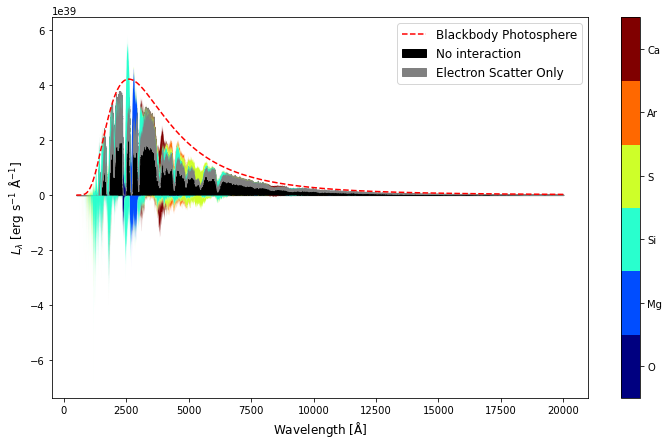

In [10]:
plotter.generate_plot_mpl(show_modeled_spectrum=False);

### Additional plotting options

In [11]:
# To list all avaialble options (or parameters) with their description
help(plotter.generate_plot_mpl)

Help on method generate_plot_mpl in module tardis.visualization.tools.sdec_plot:

generate_plot_mpl(packets_mode='virtual', packet_wvl_range=None, distance=None, show_modeled_spectrum=True, ax=None, figsize=(12, 7), cmapname='jet', nelements=None) method of tardis.visualization.tools.sdec_plot.SDECPlotter instance
    Generate Spectral element DEComposition (SDEC) Plot using matplotlib.
    
    Parameters
    ----------
    packets_mode : {'virtual', 'real'}, optional
        Mode of packets to be considered, either real or virtual. Default
        value is 'virtual'
    packet_wvl_range : astropy.Quantity or None, optional
        Wavelength range to restrict the analysis of escaped packets. It
        should be a quantity having units of Angstrom, containing two
        values - lower lambda and upper lambda i.e.
        [lower_lambda, upper_lambda] * u.AA. Default value is None
    distance : astropy.Quantity or None, optional
        Distance used to calculate flux instead of lumi

The `generate_plot_mpl` method also has options specific to the matplotlib API, thereby providing you more control over how your SDEC plot looks. Possible cases where you may use them are:

- `ax`: To plot SDEC on the Axis of a plot you're already working with, e.g. for subplots.

- `figsize`: To resize SDEC plot as per your requirements.

- `cmapname`: To use a colormap of your preference, instead of "jet".

## Interactive Plot (in plotly)
If you're using SDEC plot for exploration purposes, you should plot its interactive version by using `generate_plot_ply()`. This not only allows you to zoom & pan but also to inspect data values by hovering, to resize scale, etc. conveniently (as shown below).

![Interactions possible with SDEC plotly plot](../images/sdec_ply_interaction.gif)


This method takes exact same arguments as `generate_plot_mpl` except a few that are specific to the plotting library. We can produce all the plots above in plotly, by passing the same arguments.

### Virtual packets mode

In [12]:
%%latex
$done~to~render~latex$

<IPython.core.display.Latex object>

In [13]:
plotter.generate_plot_ply()

### Real packets mode

In [14]:
plotter.generate_plot_ply(packets_mode="real")

### Plotting a specific wavelength range

In [15]:
plotter.generate_plot_ply(packet_wvl_range=[3000, 9000] * u.AA)

In similar manner, you can also use `show_modeled_spectrum` and `distance` argument in plotly plots.

### Additional plotting options

In [16]:
# To list all avaialble options (or parameters) with their description
help(plotter.generate_plot_ply)

Help on method generate_plot_ply in module tardis.visualization.tools.sdec_plot:

generate_plot_ply(packets_mode='virtual', packet_wvl_range=None, distance=None, observed_spectrum=None, show_modeled_spectrum=True, fig=None, graph_height=600, cmapname='jet', nelements=None) method of tardis.visualization.tools.sdec_plot.SDECPlotter instance
    Generate interactive Spectral element DEComposition (SDEC) Plot using plotly.
    
    Parameters
    ----------
    packets_mode : {'virtual', 'real'}, optional
        Mode of packets to be considered, either real or virtual. Default
        value is 'virtual'
    packet_wvl_range : astropy.Quantity or None, optional
        Wavelength range to restrict the analysis of escaped packets. It
        should be a quantity having units of Angstrom, containing two
        values - lower lambda and upper lambda i.e.
        [lower_lambda, upper_lambda] * u.AA. Default value is None
    distance : astropy.Quantity or None, optional
        Distance used

The `generate_plot_ply` method also has options specific to the plotly API, thereby providing you more control over how your SDEC plot looks. Possible cases where you may use them are:
- `fig`: To plot SDEC on a figure you are already using e.g. for subplots.
- `graph_height`: To specify the height of graph as needed.
- `cmapname`: To use colormap of your preference instead of "jet".

## Using simulation saved as HDF
Other than producing SDEC Plot for simulation objects in runtime, you can also produce it for saved TARDIS simulations.

In [16]:
hdf_plotter = SDECPlotter.from_hdf("demo.hdf")

This `hdf_plotter` object is similar to the `plotter` object we used above, so you can use each plotting method demonstrated above with this too.

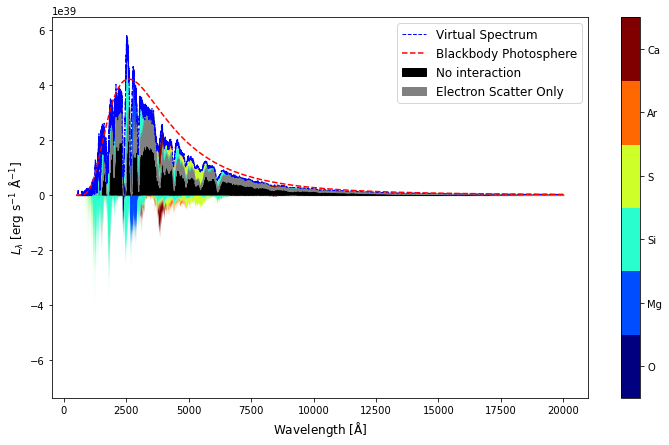

In [17]:
# Static plot with virtual packets mode
hdf_plotter.generate_plot_mpl();

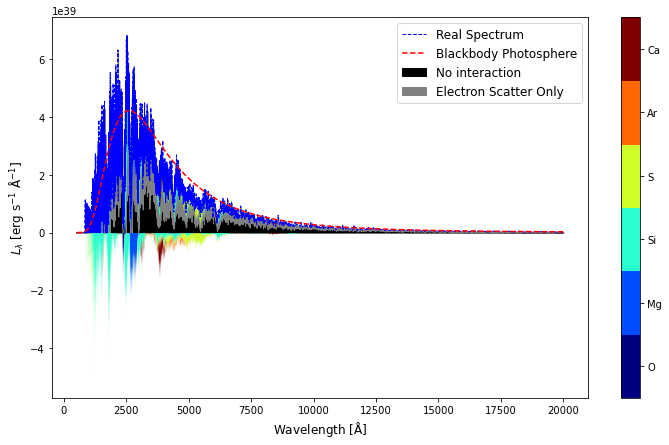

In [18]:
# Static plot with real packets mode
hdf_plotter.generate_plot_mpl("real");

In [19]:
# Interactive plot with virtual packets mode
hdf_plotter.generate_plot_ply()